In [1]:
import os
import math
import cv2
import numpy as np
import utils
import tensorflow as tf
import tensorflow.contrib.slim as slim
import matplotlib.pyplot as plt
import itertools
from libs.networks.network_factory import get_network_byname
from libs import build_rpn, build_fast_rcnn, build_fpn
from data.read_tfrecord import eval_predict_input_fn
from config import Config
from libs.visualize import display_instances
from libs.label_dict import LABEl_NAME_MAP
from tools.test import model_fn

%matplotlib inline 

/root/userfolder/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:34: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


####  Define the evaluate function

In [2]:
def compute_match(gt_boxes, gt_class_ids,
               pred_boxes, pred_class_ids, pred_scores,
               iou_threshold=0.5):
    """Compute Average Precision at a set IoU threshold (default 0.5).

    Returns:
    gt_match_dict: array for gt has been preded(1 be for has been pred, 0 for don't been pred) 
    pred_match_dict: array for pred is or not right(1 is right, 0 is wrong)
    pred_scores_dict: array for has been sorted.(be correspend to pred_match)

    """
    gt_match_dict = {}
    pred_match_dict = {}
    pred_scores_dict = {}
    # Trim zero padding and sort predictions by score from high to low
    # TODO: cleaner to do zero unpadding upstream
    gt_boxes = utils.trim_zeros(gt_boxes)
    pred_boxes = utils.trim_zeros(pred_boxes)
    pred_scores = pred_scores[:pred_boxes.shape[0]]
    indices = np.argsort(pred_scores)[::-1]
    pred_boxes = pred_boxes[indices]
    pred_class_ids = pred_class_ids[indices]
    pred_scores = pred_scores[indices]
    
    # Compute IoU overlaps [pred_boxes, gt_boxes]
    overlaps = utils.compute_overlaps(pred_boxes, gt_boxes)
    
    # Loop through ground truth boxes and find matching predictions
    match_count = 0
    pred_match = np.zeros([pred_boxes.shape[0]])
    gt_match = np.zeros([gt_boxes.shape[0]])
    for i in range(len(pred_boxes)):
        # Find best matching ground truth box
        sorted_ixs = np.argsort(overlaps[i])[::-1]
        for j in sorted_ixs:
            # If ground truth box is already matched, go to next one
            if gt_match[j] == 1:
                continue
            # If we reach IoU smaller than the threshold, end the loop
            iou = overlaps[i, j]
            if iou < iou_threshold:
                break
            # Do we have a match?
            if pred_class_ids[i] == gt_class_ids[j]:
                match_count += 1
                gt_match[j] = 1
                pred_match[i] = 1
                break
    for class_id in range(1,12):
        gt_match_dict[class_id] =  gt_match[gt_class_ids==class_id]
        pred_match_dict[class_id] = pred_match[pred_class_ids==class_id]
        pred_scores_dict[class_id] = pred_scores[pred_class_ids==class_id]
    return gt_match_dict, pred_match_dict, pred_scores_dict

def compute_class_mAP(single_record):
    """
    single_record: the single result of model(it is a generator)
    
    all_class_mAP(array): all class AP.
    """
    
    all_gt_match_dict = {}
    all_pred_match_dict = {}
    all_pred_scores_dict = {}
    for class_id in range(1,12):
        all_gt_match_dict[class_id] = np.array([])
        all_pred_match_dict[class_id]= np.array([])
        all_pred_scores_dict[class_id]= np.array([])
        
    while True:
        # Load
        try:
            np_single_sample = next(single_record)
            predict_bbox = np.round(np_single_sample["predict_bbox"]) 
            predict_class_id = np_single_sample["predict_class_id"].astype(np.int32)
            predict_scores = np_single_sample["predict_scores"]
            gt_bbox = np_single_sample["gt_box_labels"][:, :4]
            gt_class_id = np_single_sample["gt_box_labels"][:, 4]
            # Run object detection
            # Compute AP
            gt_match_dict, pred_match_dict, pred_scores_dict =\
                compute_match(gt_bbox, gt_class_id,
                              predict_bbox, predict_class_id,
                              predict_scores)
            for class_id in range(1,12):
                all_gt_match_dict[class_id] = np.concatenate([all_gt_match_dict[class_id],gt_match_dict[class_id]])
                all_pred_match_dict[class_id]= np.concatenate([all_pred_match_dict[class_id],pred_match_dict[class_id]])
                all_pred_scores_dict[class_id]= np.concatenate([all_pred_scores_dict[class_id],pred_scores_dict[class_id]])
        except:
            break
            
    all_class_mAP = np.zeros([11])
    for class_id in range(1,12):
        gt_match = all_gt_match_dict[class_id]
        pred_match = all_pred_match_dict[class_id]
        pred_score = all_pred_scores_dict[class_id]
        indices = np.argsort(pred_score)[::-1]
        pred_scores = pred_score[indices]
        pred_match = pred_match[indices]
        # Compute precision and recall at each prediction box step
        precisions = np.cumsum(pred_match) / (np.arange(len(pred_match)) + 1)
        recalls = np.cumsum(pred_match).astype(np.float32) / len(gt_match)

        # Pad with start and end values to simplify the math
        precisions = np.concatenate([[0], precisions, [0]])
        recalls = np.concatenate([[0], recalls, [1]])

        # Ensure precision values decrease but don't increase. This way, the
        # precision value at each recall threshold is the maximum it can be
        # for all following recall thresholds, as specified by the VOC paper.
        for i in range(len(precisions) - 2, -1, -1):
            precisions[i] = np.maximum(precisions[i], precisions[i + 1])

        # Compute mean AP over recall range
        indices = np.where(recalls[:-1] != recalls[1:])[0] + 1
        mAP = np.sum((recalls[indices] - recalls[indices - 1]) *
                     precisions[indices])
        all_class_mAP[class_id-1] = mAP
    return all_class_mAP

### Define prediction generator 

In [3]:
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
class PConfig(Config):
    PER_GPU_IMAGE = 1

net_config = PConfig()
session_config = tf.ConfigProto()
session_config.gpu_options.allow_growth = True
session_config.allow_soft_placement = True
estimator_config = tf.estimator.RunConfig(model_dir=net_config.MODLE_DIR,
                                          session_config=session_config)

my_estimator = tf.estimator.Estimator(model_fn,
                                      params={"net_config": net_config}, 
                                      config=estimator_config)
single_record = my_estimator.predict(input_fn=lambda: 
                                     eval_predict_input_fn(net_config.DATA_DIR),
                                     yield_single_examples=True)

INFO:tensorflow:Using config: {'_model_dir': './logs', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': gpu_options {
  allow_growth: true
}
allow_soft_placement: true
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x7fa6f6a17630>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}


In [4]:
all_mAP = compute_class_mAP(single_record)

INFO:tensorflow:Calling model_fn.


/root/userfolder/anaconda3/lib/python3.6/site-packages/scipy/misc/pilutil.py:482: FutureWarning: Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.
  if issubdtype(ts, int):
/root/userfolder/anaconda3/lib/python3.6/site-packages/scipy/misc/pilutil.py:485: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  elif issubdtype(type(size), float):


INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./logs/model.ckpt-199980
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.


In [ ]:
import pandas as pd
class_names = LABEl_NAME_MAP
all_mAP_add = np.concatenate([all_mAP,np.array([np.mean(all_mAP)])])
allclass_mAP = pd.DataFrame(all_mAP_add,index=[class_names[i] for i in range(1,12)] + ["mAP"])
display(allclass_mAP)

### compute the recall of RPN

In [6]:
def compute_recall_match(pred_boxes, gt_boxes, iou):
    """Compute the recall at the given IoU threshold. It's an indication
    of how many GT boxes were found by the given prediction boxes.

    pred_boxes: [N, (y1, x1, y2, x2)] in image coordinates
    gt_boxes: [N, (y1, x1, y2, x2)] in image coordinates
    """
    # Measure overlaps
    overlaps = utils.compute_overlaps(pred_boxes, gt_boxes)
    iou_max = np.max(overlaps, axis=1)
    iou_argmax = np.argmax(overlaps, axis=1)
    positive_ids = np.where(iou_max >= iou)[0]
    matched_gt_boxes = iou_argmax[positive_ids]

    return len(set(matched_gt_boxes)), gt_boxes.shape[0]
def compute_proposal_recall(single_record, use_scores_threshold=False, scores_threshold=0.5):
    """
    single_record: the single result of model(it is a generator)
    return: the recall of rpn
    """
    match_nums = 0.0
    gt_nums = 0.0
    while True:
        try:
            np_single_sample = next(single_record)
            rpn_proposal_boxes = np.round(np_single_sample["rpn_proposal_boxes"])
            if use_scores_threshold:
                rpn_proposals_scores = np_single_sample["rpn_proposals_scores"]
                rpn_proposal_boxes = rpn_proposal_boxes[rpn_proposals_scores > scores_threshold]
            gt_bbox = np_single_sample["gt_box_labels"][:, :4]
            gt_class_id = np_single_sample["gt_box_labels"][:, 4]
            match_num, gt_num = compute_recall_match(rpn_proposal_boxes, gt_bbox, 0.5)
            match_nums += match_num
            gt_nums += gt_num
        except:
            break
    return match_nums / gt_nums


In [7]:
rpn_single_record = my_estimator.predict(input_fn=lambda: 
                                     eval_predict_input_fn(net_config.DATA_DIR),
                                     yield_single_examples=True)
proposal_recall = compute_proposal_recall(rpn_single_record)
print("the recall of proposal is {}".format(proposal_recall))

INFO:tensorflow:Calling model_fn.


/root/userfolder/anaconda3/lib/python3.6/site-packages/scipy/misc/pilutil.py:482: FutureWarning: Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.
  if issubdtype(ts, int):
/root/userfolder/anaconda3/lib/python3.6/site-packages/scipy/misc/pilutil.py:485: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  elif issubdtype(type(size), float):


INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./logs/model.ckpt-199980
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
the recall of proposal is 0.8781239301609038


### Recall after threhold

In [8]:
rpn_single_record = my_estimator.predict(input_fn=lambda: 
                                     eval_predict_input_fn(net_config.DATA_DIR),
                                     yield_single_examples=True)
proposal_recall = compute_proposal_recall(rpn_single_record, use_scores_threshold=True, scores_threshold=0.5)
print("the recall of proposal is {}".format(proposal_recall))

INFO:tensorflow:Calling model_fn.


/root/userfolder/anaconda3/lib/python3.6/site-packages/scipy/misc/pilutil.py:482: FutureWarning: Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.
  if issubdtype(ts, int):
/root/userfolder/anaconda3/lib/python3.6/site-packages/scipy/misc/pilutil.py:485: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  elif issubdtype(type(size), float):


INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./logs/model.ckpt-199980
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
the recall of proposal is 0.8449161246148579


### Errors analysis

#### Define the compute batch average precision function

In [9]:
def compute_batch_ap(single_record):
    """"
    single_record: the single result of model(it is a generator)
    return:
    MAP: all image map
    all_image_class_errors: all object classifiar errors
    all_image_omit_det: all object omit detection
    all_image_false_positive: all object false positive
    """
    APs = []
    all_image_class_errors = []
    all_image_omit_det = []
    all_image_false_positive = []
    while True:
        try:
            single_sample_result = next(single_record)
            if np.shape(single_sample_result["gt_box_labels"])[0] == 0:
                continue
            AP, precisions, recalls, overlaps,class_errors, omit_det, false_positive =\
                utils.compute_ap(single_sample_result["gt_box_labels"][:, :4],
                                 single_sample_result["gt_box_labels"][:, 4],
                                 single_sample_result["predict_bbox"], 
                                 single_sample_result["predict_class_id"].astype(np.int32), 
                                 single_sample_result["predict_scores"])
                                 
            # add the image_id for all items
            [item.__setitem__("image_name", single_sample_result["image_name"]) for item in class_errors]
            [item.__setitem__("image_name", single_sample_result["image_name"]) for item in omit_det]
            [item.__setitem__("image_name", single_sample_result["image_name"]) for item in false_positive]
            # add the image for all items
            [item.__setitem__("image", single_sample_result["image"]) for item in class_errors]
            [item.__setitem__("image", single_sample_result["image"]) for item in omit_det]
            [item.__setitem__("image", single_sample_result["image"]) for item in false_positive]                    

            # add to all images summary
            all_image_class_errors.extend(class_errors)
            all_image_omit_det.extend(omit_det)
            all_image_false_positive.extend(false_positive)
            APs.append(AP)
        except:
            break
    return np.mean(APs), all_image_class_errors, all_image_omit_det, all_image_false_positive                     
    

#### compute batch mAP and errors dict

In [10]:
# Compute VOC-style Average Precision
batch_single_record = my_estimator.predict(input_fn=lambda: 
                                     eval_predict_input_fn(net_config.DATA_DIR),
                                     yield_single_examples=True)
mAP, all_image_class_errors, all_image_omit_det, all_image_false_positive = compute_batch_ap(batch_single_record)

INFO:tensorflow:Calling model_fn.


/root/userfolder/anaconda3/lib/python3.6/site-packages/scipy/misc/pilutil.py:482: FutureWarning: Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.
  if issubdtype(ts, int):
/root/userfolder/anaconda3/lib/python3.6/site-packages/scipy/misc/pilutil.py:485: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  elif issubdtype(type(size), float):


INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from ./logs/model.ckpt-199980
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
mAP @ IoU=50:  0.348181814724479


#### Define visualization function

In [11]:
def get_ax(rows=1, cols=1, size=16):
    """Return a Matplotlib Axes array to be used in
    all visualizations in the notebook. Provide a
    central point to control graph sizes.
    
    Adjust the size attribute to control how big to render images
    """
    _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
    return ax


def plot_overlaps(table, class_names, title):
    """Draw a grid showing how ground truth objects are classified.
    table: (gt_num, pred_num)[first dims == y, second dims == x]
    class_names: list of all class names in the dataset
    threshold: Float. The prediction probability required to predict a class
    """
    y_len, x_len = table.shape
    table = table[::-1]
    plt.figure(figsize=(12, 10))
    plt.imshow(table, interpolation='nearest', cmap=plt.cm.Blues)
    plt.yticks(np.arange(y_len)[::-1],
               ["{}".format(class_names[i])
                for i in range(y_len)])
    plt.xticks(np.arange(x_len),
               ["{}".format(class_names[i])
                for i in range(x_len)], rotation=90)

    for i, j in itertools.product(range(y_len),
                                  range(x_len)):
        plt.text(j, i, "{:.3f}".format(table[i, j]),
                 horizontalalignment="center", verticalalignment="center",
                 fontsize=9)
    plt.tight_layout()
    plt.title(title)
    plt.xlabel("Wrong Predictions")
    plt.ylabel("Ground Truth")
    
def plot_image_table(image_list):
    """
    image_list: 64 objects to show.[{"image_name":,"image":, "gt_category_id":, "pred_bbox":, "pred_category_id"}]
    """
    assert len(image_list) == 64
    axs = get_ax(rows=8, cols=8, size=8)
    class_names = {0:"back_ground", 1:"ascus", 2:"asch", 3:"lsil", 4:"hsil", 5:"scc",
                  6:"agc", 7:"trichomonas", 8:"candida", 9:"flora", 10:"herps", 11:"actinomyces"}
    margin = 2                           
    for i in range(len(axs)):
        for j in range(len(axs[0])): 
            # Set the ax attributes
            ax = axs[i][j]
            ax.set_ylim(500 + margin, -margin) # 这里需要调整
            ax.set_xlim(-margin, 500 + margin)
            ax.axis('off')

            #Load the image 
            image_info = image_list[i*8+j]
            image = image_info["image"]
            
            bbox = image_info["gt_box"] if "gt_box" in image_info.keys() else image_info["pred_box"]# or pred_box
            bbox = bbox.astype(np.int32)
            object_image = image[bbox[0]:bbox[2],bbox[1]:bbox[3],:]
            maxside = max(object_image.shape)
            scale_factor = 400 / maxside
            object_image = cv2.resize(object_image,None,fx=scale_factor, fy=scale_factor, interpolation = cv2.INTER_CUBIC)

            # add the notation
            gt_name = class_names[image_info["gt_category_id"]] if "gt_category_id" in image_info.keys() else None
            pred_name = class_names[image_info["pred_category_id"]] if "pred_category_id" in image_info.keys() else None
            caption = "gt_category:{} \n wrong_category:{}".format(gt_name, pred_name)
            ax.text(0, 0, caption, size=25, verticalalignment='top',
                color='w', backgroundcolor="none",
                bbox={'facecolor': "green", 'alpha': 0.5,
                      'pad': 2, 'edgecolor': 'none'})
            ax.imshow(object_image.astype(np.uint8))

#### the error of fast_rcnn classifier
draw out the number of instances which is wrong caused by classifier

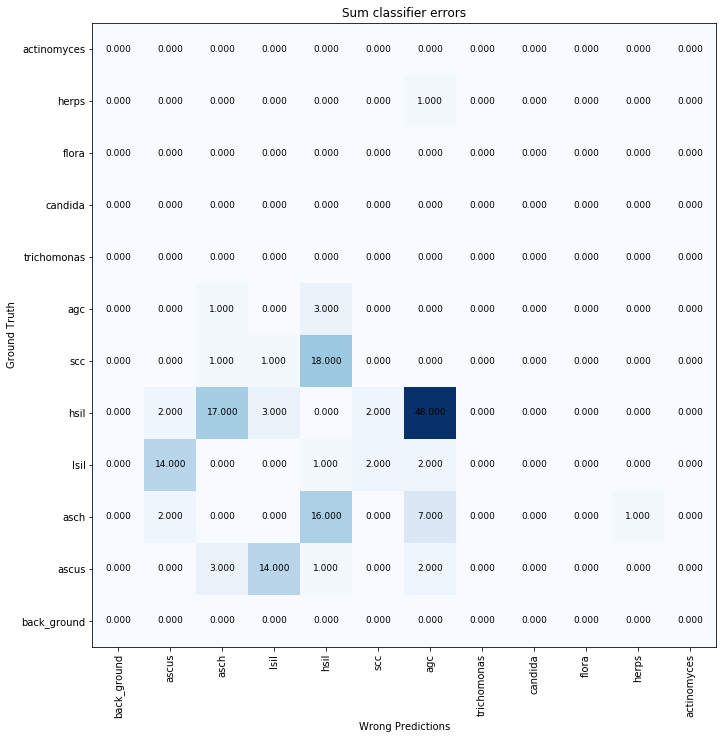

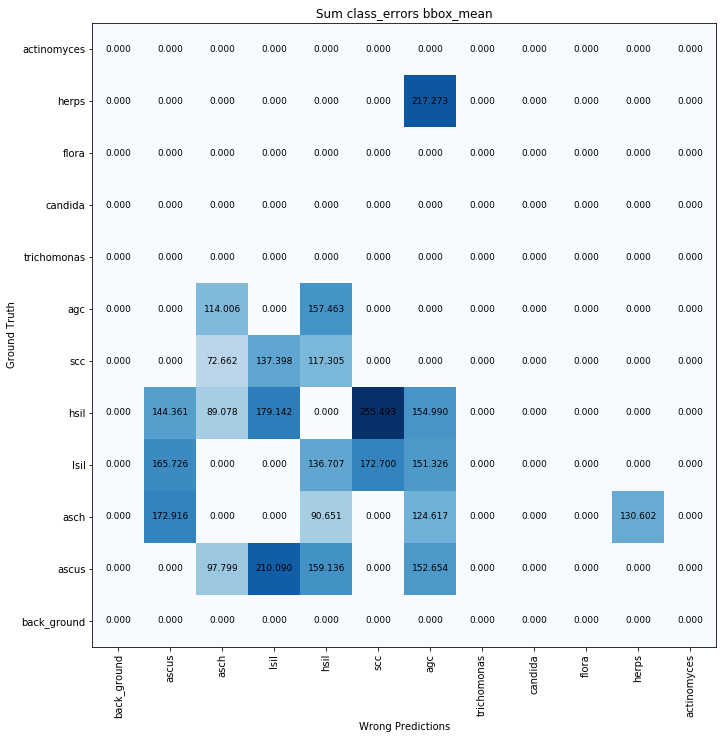

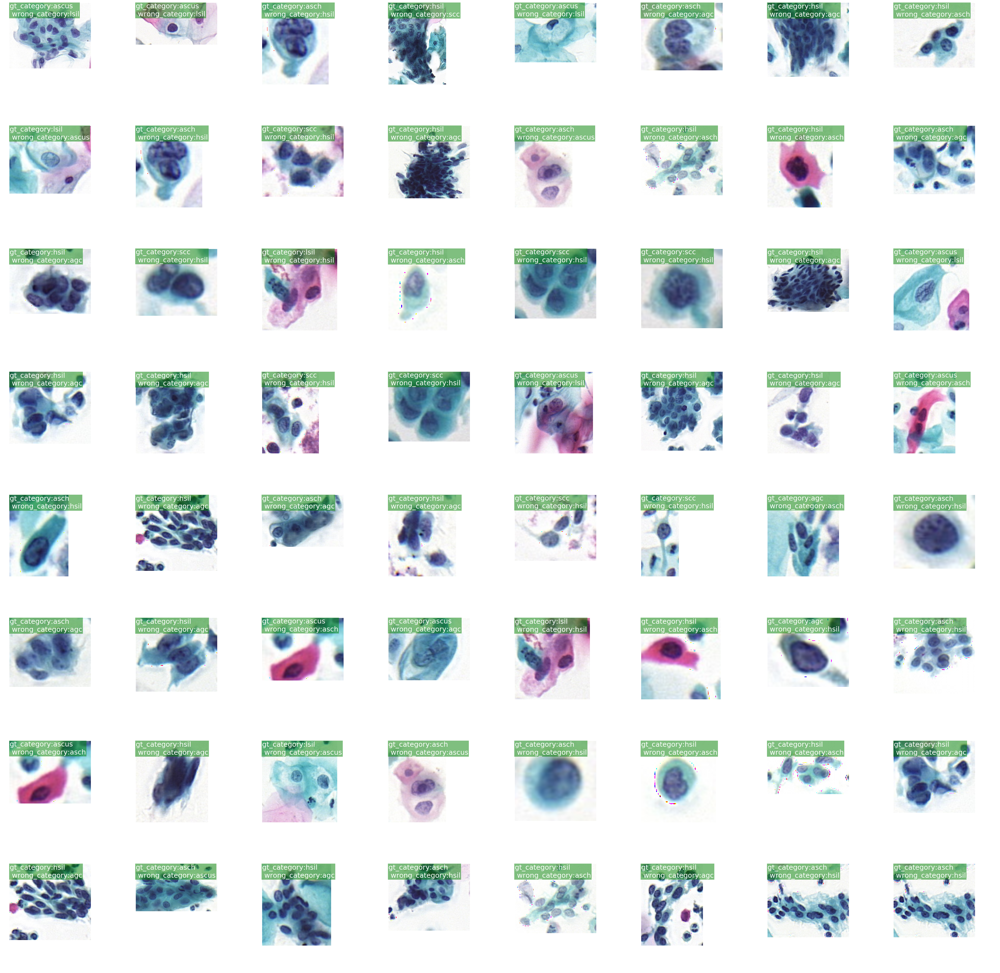

In [12]:
# summary the total num for each station class_errors
table_class_id = np.zeros((net_config.NUM_CLASS, net_config.NUM_CLASS)) # first dims is gt, the second dims is pred
table_bbox_sum = np.zeros((net_config.NUM_CLASS, net_config.NUM_CLASS))
for item in all_image_class_errors:
    i = item["gt_category_id"]
    j = item["pred_category_id"]
    table_class_id[i,j] += 1
    bbox = item["pred_box"]
    side = np.sqrt((bbox[2] - bbox[0]) * (bbox[3] - bbox[1]))
    table_bbox_sum[i,j] += side

# plot the summary table

plot_overlaps(table_class_id, class_names, "Sum classifier errors")
# deal with the divide is zeros states
# let division is zeros become 1, don't infenceresult
table_class_id[table_class_id==0] = 1
table_bbox_mean = table_bbox_sum / table_class_id

plot_overlaps(table_bbox_mean, class_names, "Sum class_errors bbox_mean")
index = np.random.choice(range(len(all_image_class_errors)), 64)
all_image_class_errors = np.array(all_image_class_errors)
show_image_info = all_image_class_errors[index]
plot_image_table(show_image_info)

#### Summary the missing objects
missing objects means they are true objects but detection failure beacuse of their scores 
is below FINAL_SCORE_THRESHOLD or they are not in proposals.

,back_ground,ascus,asch,lsil,hsil,scc,agc,trichomonas,candida,flora,herps,actinomyces
count,0.0,148.000000,369.000000,95.000000,2338.000000,226.000000,300.000000,178.000000,7.000000,10.000000,9.00000,3.000000
bbox_mean,0.0,140.747648,78.949048,163.535995,80.900797,83.520658,99.206042,28.165341,220.941693,110.962412,145.03064,71.497607


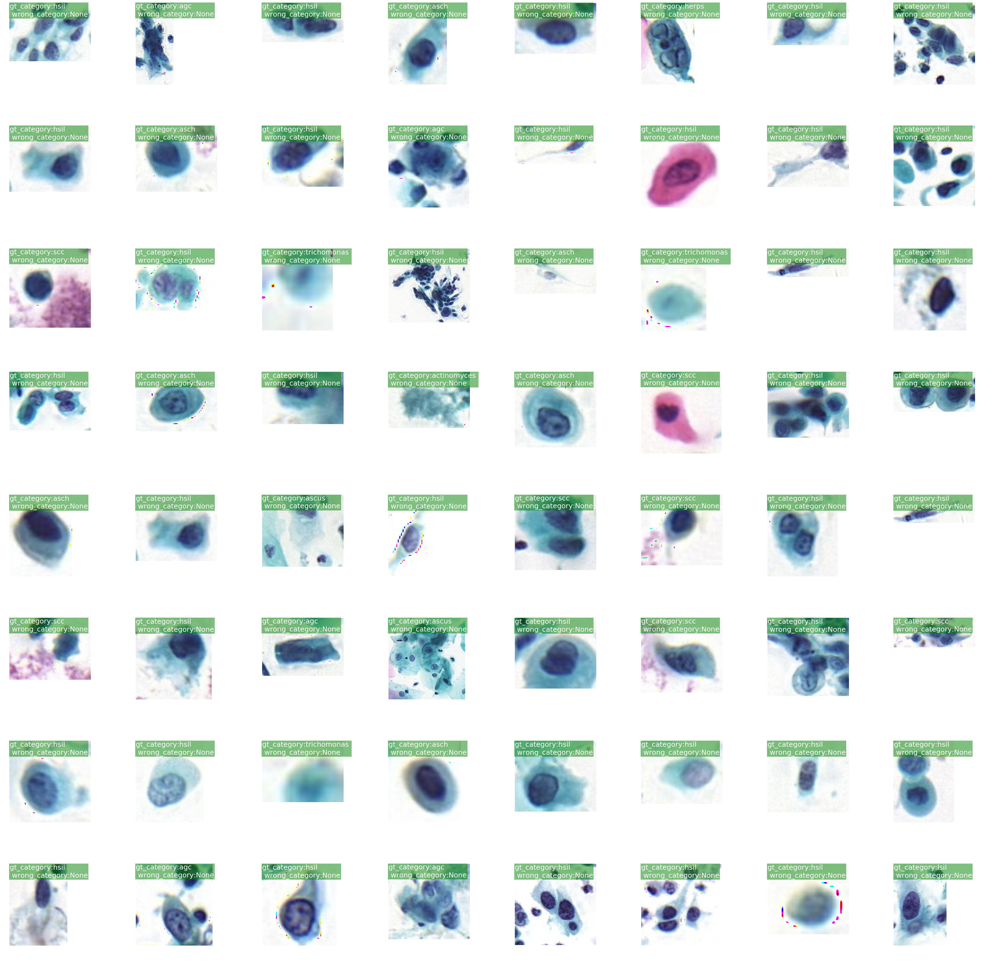

In [13]:
import pandas as pd
omit_table = np.zeros((2, net_config.NUM_CLASS))
for item in all_image_omit_det:
    id = item["gt_category_id"]
    omit_table[0,id] += 1
    bbox = item["gt_box"]
    side = np.sqrt((bbox[2] - bbox[0]) * (bbox[3] - bbox[1]))
    omit_table[1,id] += side

equal_zero = omit_table[0]==0
omit_table[0,equal_zero] = 1
omit_table[1:] /= omit_table[0]
omit_table[0,equal_zero] = 0
omit_table = pd.DataFrame(omit_table,columns=[class_names[i] for i in range(12)],index=['count','bbox_mean'])
display(omit_table)
index = np.random.choice(range(len(all_image_omit_det)), 64)
all_image_omit_det = np.array(all_image_omit_det)
show_image_info = all_image_omit_det[index]
plot_image_table( show_image_info)

#### False positive

,back_ground,ascus,asch,lsil,hsil,scc,agc,trichomonas,candida,flora,herps,actinomyces
count,0.0,77.000000,55.000000,48.000000,186.000000,11.000000,258.000000,283.000000,16.000000,13.000000,10.000000,8.000000
bbox_mean,0.0,161.546715,87.093515,192.881695,125.121043,186.812901,118.883505,28.778657,231.458796,115.711692,137.824686,79.528090
scores_means,0.0,0.838691,0.776087,0.847923,0.789680,0.761789,0.854946,0.844273,0.887140,0.818603,0.917095,0.941609


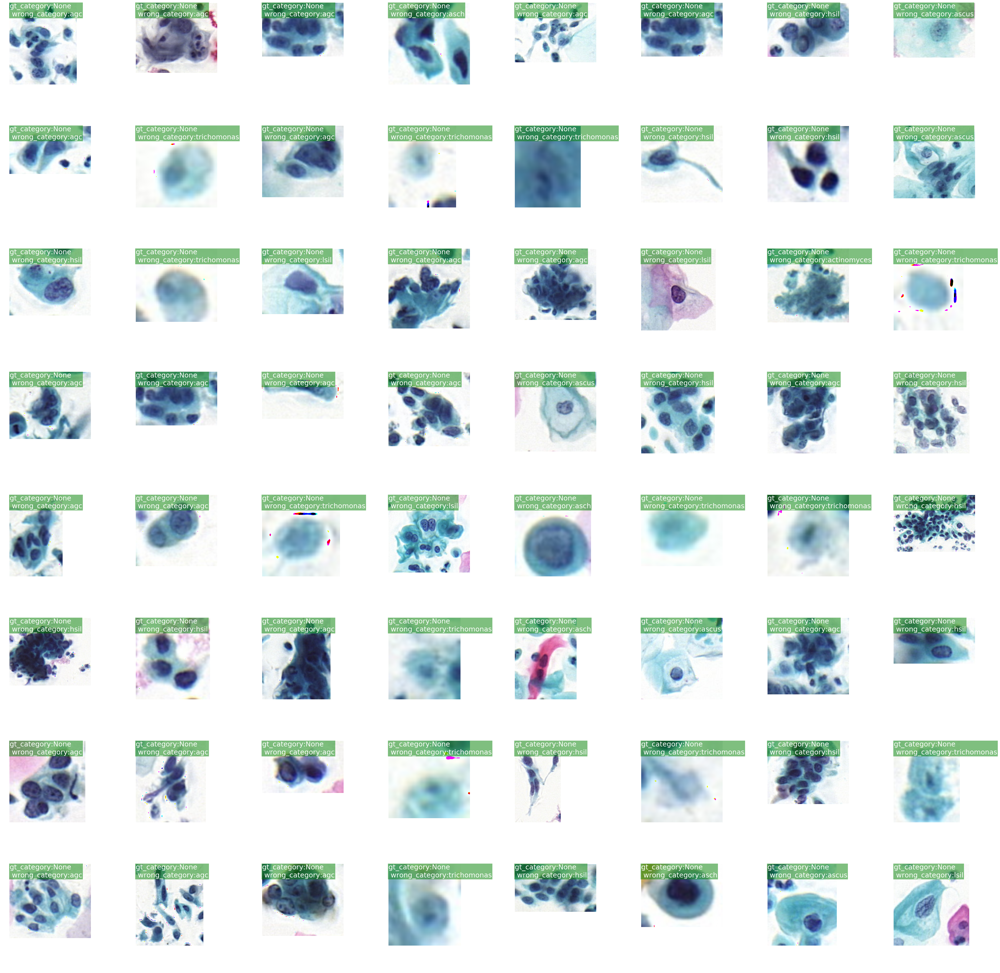

In [14]:
FP_table = np.zeros((3, net_config.NUM_CLASS))
for item in all_image_false_positive:
    id = item["pred_category_id"]
    FP_table[0,id] += 1
    bbox = item["pred_box"]
    side = np.sqrt((bbox[2] - bbox[0]) * (bbox[3] - bbox[1]))
    FP_table[1,id] += side
    FP_table[2, id] += item["pred_score"]
    
equal_zero = FP_table[0]==0
FP_table[0,equal_zero] = 1
FP_table[1:] /= FP_table[0]
FP_table[0,equal_zero] = 0
omit_table = pd.DataFrame(FP_table,columns=[class_names[i] for i in range(12)],index=['count','bbox_mean','scores_means'])
display(omit_table)
index = np.random.choice(range(len(all_image_false_positive)), 64)
all_image_false_positive = np.array(all_image_false_positive)
show_image_info = all_image_false_positive[index]
plot_image_table(show_image_info)